In [1]:
import os
import subprocess
import warnings
import rasterio
import geopandas as gpd
import matplotlib.pyplot as plt
from rasterio.plot import show

# Import functions from detectree2 and detectron2
from detectree2.preprocessing.tiling import tile_data
from detectree2.models.train import setup_cfg
from detectree2.models.predict import predict_on_data
from detectree2.models.outputs import project_to_geojson, stitch_crowns, clean_crowns
from detectron2.engine import DefaultPredictor

def install_detectree2():
    """
    Install the detectree2 package from GitHub.
    This function runs a pip install command.
    """
    subprocess.check_call(["pip", "install", "git+https://github.com/PatBall1/detectree2.git"])

def download_pretrained_model(model_url, output_path):
    """
    Download the pretrained model from a given URL.

    Parameters
    ----------
    model_url : str
        URL to download the pretrained model.
    output_path : str
        Local file path to save the downloaded model.
    
    Returns
    -------
    output_path : str
        The local file path of the downloaded model.
    """
    subprocess.check_call(["wget", model_url, "-O", output_path])
    return output_path

def tile_orthomosaic(img_path, tiles_path, buffer=20, tile_width=45, tile_height=45, dtype_bool=True):
    """
    Tile the entire orthomosaic image to prepare for predictions.

    Parameters
    ----------
    img_path : str
        Path to the input orthomosaic (TIFF) image.
    tiles_path : str
        Directory where the generated tiles will be stored.
    buffer : int, optional
        Buffer size for tiling (default is 20).
    tile_width : int, optional
        Tile width (default is 45).
    tile_height : int, optional
        Tile height (default is 45).
    dtype_bool : bool, optional
        Whether to use a boolean data type for tiling (default is True).

    Returns
    -------
    None
    """
    if not os.path.exists(tiles_path):
        os.makedirs(tiles_path)
    tile_data(img_path, tiles_path, buffer, tile_width, tile_height, dtype_bool=dtype_bool)

def setup_detection_config(trained_model_path):
    """
    Setup the configuration for tree crown detection using the pretrained model.

    Parameters
    ----------
    trained_model_path : str
        Path to the pretrained model file.
    
    Returns
    -------
    cfg : detectron2.config.Config
        Configuration object for predictions.
    """
    cfg = setup_cfg(update_model=trained_model_path)
    return cfg

def predict_tree_crowns(tiles_path, cfg, device='cpu'):
    """
    Run the prediction on the tiled data using the provided configuration.

    Parameters
    ----------
    tiles_path : str
        Directory containing the tiles.
    cfg : detectron2.config.Config
        Detection configuration.
    device : str, optional
        Device to run predictions on (default is 'cpu').

    Returns
    -------
    None
    """
    # Uncomment the line below to set the device if needed:
    # cfg.MODEL.DEVICE = device
    predictor = DefaultPredictor(cfg)
    predict_on_data(directory=tiles_path, predictor=predictor)

def reproject_predictions(tiles_path):
    """
    Reproject the predictions into geographical space.

    Parameters
    ----------
    tiles_path : str
        Directory where the prediction outputs are stored.
    
    Returns
    -------
    geo_predictions_folder : str
        Folder where the geo-referenced predictions are saved.
    """
    predictions_folder = os.path.join(tiles_path, "predictions/")
    geo_predictions_folder = os.path.join(tiles_path, "predictions_geo/")
    project_to_geojson(tiles_path, predictions_folder, geo_predictions_folder)
    return geo_predictions_folder

def stitch_and_clean_crowns(geo_predictions_folder, iou_threshold=0.7, confidence_threshold=0.5, simplify_tolerance=0.3):
    """
    Stitch predictions into full site crowns and clean overlapping detections.

    Parameters
    ----------
    geo_predictions_folder : str
        Folder containing geo-referenced predictions.
    iou_threshold : float, optional
        IoU threshold for cleaning overlapping crowns (default is 0.7).
    confidence_threshold : float, optional
        Confidence threshold for cleaning crowns (default is 0.5).
    simplify_tolerance : float, optional
        Tolerance for geometry simplification (default is 0.3).

    Returns
    -------
    crowns : GeoDataFrame
        Cleaned crown predictions.
    """
    # Stitch the crowns together
    crowns = stitch_crowns(geo_predictions_folder, 1)
    # Remove invalid geometries and simplify
    crowns = crowns[crowns.is_valid]
    crowns = crowns.set_geometry(crowns.simplify(simplify_tolerance))
    # Clean overlapping crowns
    crowns = clean_crowns(crowns, iou_threshold, confidence_threshold)
    return crowns

def save_crowns(crowns, output_file):
    """
    Save the final crown predictions as a GeoPackage.

    Parameters
    ----------
    crowns : GeoDataFrame
        GeoDataFrame of crown predictions.
    output_file : str
        Output file path (e.g., "crowns_map.gpkg").
    
    Returns
    -------
    None
    """
    crowns.to_file(output_file, driver="GPKG")

def zip_tiles_folder(tiles_folder, zip_file):
    """
    Zip the entire tiles folder.

    Parameters
    ----------
    tiles_folder : str
        Directory path containing tiles.
    zip_file : str
        Output zip file name.
    
    Returns
    -------
    None
    """
    subprocess.check_call(["zip", "-r", zip_file, tiles_folder])

def visualize_crowns(crowns, img_path=None):
    """
    Visualize the predicted crowns. If an orthomosaic is provided, overlay the crowns.

    Parameters
    ----------
    crowns : GeoDataFrame
        GeoDataFrame containing crown geometries.
    img_path : str, optional
        Path to the original orthomosaic image.
    
    Returns
    -------
    None
    """
    fig, ax = plt.subplots(figsize=(10, 10))
    if img_path and os.path.exists(img_path):
        with rasterio.open(img_path) as src:
            show(src, ax=ax)
        title = "Orthomosaic with Predicted Crowns"
    else:
        title = "Predicted Crowns"
    crowns.plot(ax=ax, facecolor='none', edgecolor='red')
    ax.set_title(title)
    plt.show()

def tree_crown_detection_pipeline(
    img_path,
    tiles_path,
    trained_model_path,
    model_url=None,
    download_model=False,
    buffer=20,
    tile_width=45,
    tile_height=45,
    dtype_bool=True,
    iou_threshold=0.7,
    confidence_threshold=0.5,
    simplify_tolerance=0.3,
    output_crowns_file="crowns_map.gpkg",
    zip_output=False,
    zip_file="tiles.zip",
    device='cpu'
):
    """
    Complete pipeline for tree crown detection from an orthomosaic image.

    The pipeline includes:
      1. Tiling the orthomosaic.
      2. (Optional) Downloading a pretrained model.
      3. Setting up the detection configuration.
      4. Running predictions on the tiled data.
      5. Reprojecting predictions to geographical coordinates.
      6. Stitching and cleaning crown predictions.
      7. Saving the crown predictions.
      8. Optionally zipping the tiles folder.

    Parameters
    ----------
    img_path : str
        Path to the input orthomosaic image.
    tiles_path : str
        Directory where the tiles and predictions will be stored.
    trained_model_path : str
        Local path for the pretrained model file.
    model_url : str, optional
        URL to download the pretrained model if needed.
    download_model : bool, optional
        Whether to download the pretrained model (default is False).
    buffer : int, optional
        Buffer size for tiling (default is 20).
    tile_width : int, optional
        Tile width (default is 45).
    tile_height : int, optional
        Tile height (default is 45).
    dtype_bool : bool, optional
        Use boolean dtype for tiling (default is True).
    iou_threshold : float, optional
        IoU threshold for cleaning crowns (default is 0.7).
    confidence_threshold : float, optional
        Confidence threshold for cleaning crowns (default is 0.5).
    simplify_tolerance : float, optional
        Tolerance for geometry simplification (default is 0.3).
    output_crowns_file : str, optional
        File name for saving the crown predictions (default is "crowns_map.gpkg").
    zip_output : bool, optional
        Whether to zip the tiles folder (default is False).
    zip_file : str, optional
        Output zip file name if zipping (default is "tiles.zip").
    device : str, optional
        Device to run predictions on (default is 'cpu').

    Returns
    -------
    crowns : GeoDataFrame
        Final cleaned crown predictions.
    """
    # Step 1: Tile the orthomosaic image
    tile_orthomosaic(img_path, tiles_path, buffer, tile_width, tile_height, dtype_bool)
    
    # Step 2: Optionally download the pretrained model
    if download_model and model_url:
        trained_model_path = download_pretrained_model(model_url, trained_model_path)
    
    # Step 3: Setup the detection configuration
    cfg = setup_detection_config(trained_model_path)
    # Uncomment the next line to set the device if required
    # cfg.MODEL.DEVICE = device
    
    # Step 4: Predict tree crowns on the tiled data
    predict_tree_crowns(tiles_path, cfg, device)
    
    # Step 5: Reproject predictions into geographical space
    geo_predictions_folder = reproject_predictions(tiles_path)
    
    # Step 6: Stitch and clean crown predictions
    crowns = stitch_and_clean_crowns(geo_predictions_folder, iou_threshold, confidence_threshold, simplify_tolerance)
    
    # Step 7: Save the crown predictions
    save_crowns(crowns, output_crowns_file)
    
    # Step 8: Optionally, zip the tiles folder
    if zip_output:
        zip_tiles_folder(tiles_path, zip_file)
    
    return crowns


  0%|          | 0/20 [00:00<?, ?it/s]

INFO:detectree2.preprocessing.tiling:Tiling complete
INFO:detectron2.checkpoint.detection_checkpoint:[DetectionCheckpointer] Loading from large_files/230103_randresize_full.pth ...
INFO:fvcore.common.checkpoint:[Checkpointer] Loading from large_files/230103_randresize_full.pth ...


Predicting 33 files in mode rgb


/home/gaurav/anaconda3/envs/drone-monitoring/lib/python3.10/site-packages/torch/functional.py:539: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:3637.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Projecting 33 files
Cleaning 2052 crowns
0 / 2052 crowns cleaned
1000 / 2052 crowns cleaned
2000 / 2052 crowns cleaned


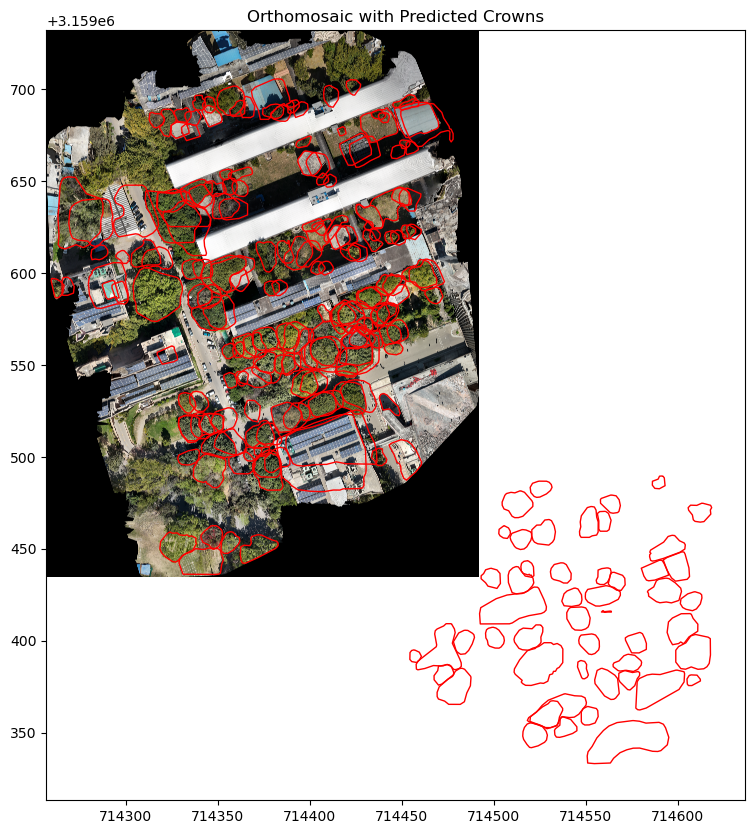

In [2]:
# Set base folder and file paths
base_folder = "large_files"
img_path = os.path.join(base_folder, "om2.tif")
tiles_path = os.path.join(base_folder, "tiles")  # This folder will be created if it doesn't exist
trained_model_path = os.path.join(base_folder, "230103_randresize_full.pth")

# Run the tree crown detection pipeline
crowns = tree_crown_detection_pipeline(
    img_path=img_path,
    tiles_path=tiles_path,
    trained_model_path=trained_model_path,
    download_model=False,  # Model is already present locally
    zip_output=False       # Set to True if you want to zip the output tiles folder
)

# Visualize the predicted crowns over the original orthomosaic
visualize_crowns(crowns, img_path)

In [8]:
import os
import geopandas as gpd
from shapely.geometry import Polygon

# Define merge functions

def merge_common_crowns_iou(crowns1, crowns2, iou_threshold=0.5):
    """
    Merge common crowns from two GeoDataFrames based on Intersection over Union (IoU).

    Parameters
    ----------
    crowns1 : GeoDataFrame
        First set of detected crowns.
    crowns2 : GeoDataFrame
        Second set of detected crowns.
    iou_threshold : float, optional
        Minimum IoU to consider two crowns as the same (default is 0.5).

    Returns
    -------
    merged : GeoDataFrame
        GeoDataFrame with merged crown geometries.
    """
    # Start with a copy of the first set.
    merged = crowns1.copy()

    # Iterate over each crown in crowns2
    for idx2, row2 in crowns2.iterrows():
        poly2 = row2.geometry
        found_match = False
        for idx1, row1 in merged.iterrows():
            poly1 = row1.geometry
            inter_area = poly1.intersection(poly2).area
            union_area = poly1.union(poly2).area
            iou = inter_area / union_area if union_area > 0 else 0
            if iou >= iou_threshold:
                # Merge the two polygons by union.
                merged.at[idx1, 'geometry'] = poly1.union(poly2)
                found_match = True
                break
        if not found_match:
            # Append crown from crowns2 that did not match any in merged.
            merged = merged.append(row2, ignore_index=True)
    return merged

def merge_common_crowns_euclidean(crowns1, crowns2, distance_threshold=10):
    """
    Merge common crowns from two GeoDataFrames based on Euclidean distance between centroids.

    Parameters
    ----------
    crowns1 : GeoDataFrame
        First set of detected crowns.
    crowns2 : GeoDataFrame
        Second set of detected crowns.
    distance_threshold : float, optional
        Maximum distance (in the CRS units) between centroids to consider two crowns the same (default is 10).

    Returns
    -------
    merged : GeoDataFrame
        GeoDataFrame with merged crown geometries.
    """
    merged = crowns1.copy()

    for idx2, row2 in crowns2.iterrows():
        centroid2 = row2.geometry.centroid
        found_match = False
        for idx1, row1 in merged.iterrows():
            centroid1 = row1.geometry.centroid
            if centroid1.distance(centroid2) <= distance_threshold:
                merged.at[idx1, 'geometry'] = row1.geometry.union(row2.geometry)
                found_match = True
                break
        if not found_match:
            merged = merged.append(row2, ignore_index=True)
    return merged

# Example usage:

# Set base folder and file paths
base_folder = "large_files"
model_path = os.path.join(base_folder, "230103_randresize_full.pth")

# Process first orthomosaic (om1.tif)
img_path1 = os.path.join(base_folder, "om1.tif")
tiles_path1 = os.path.join(base_folder, "tiles_om1")
crowns1 = tree_crown_detection_pipeline(
    img_path=img_path1,
    tiles_path=tiles_path1,
    trained_model_path=model_path,
    download_model=False,
    zip_output=False
)

# Process second orthomosaic (om2.tif)
img_path2 = os.path.join(base_folder, "om2.tif")
tiles_path2 = os.path.join(base_folder, "tiles_om2")
crowns2 = tree_crown_detection_pipeline(
    img_path=img_path2,
    tiles_path=tiles_path2,
    trained_model_path=model_path,
    download_model=False,
    zip_output=False
)

# Merge the crowns using IoU filtering
merged_crowns = merge_common_crowns_iou(crowns1, crowns2, iou_threshold=0.5)

# Alternatively, merge using Euclidean distance:
# merged_crowns = merge_common_crowns_euclidean(crowns1, crowns2, distance_threshold=10)

# Visualize merged crowns overlayed on om1.tif (or choose any orthomosaic for background)
visualize_crowns(merged_crowns, img_path1)

DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0906a9cd00>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f0908880310> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f0908880310>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0906a9cd00>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/om1.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0906a9cd00>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f0908880310> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f0908880310>.
DEBUG: Exiting outer

  0%|          | 0/16 [00:00<?, ?it/s]

DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0906a9c7f0>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f0906a9dc00> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f0906a9dc00>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0906a9c7f0>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/om1.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0906a9c7f0>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f0906a9dc00> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f0906a9dc00>.
DEBUG: Exiting outer

Predicting 12 files in mode rgb


DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0906ae8430>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f0906a9c7f0> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f0906a9c7f0>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0906ae8430>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/tiles_om1/om1_714419_3159599_45_20_32643.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0906ae8430>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f0906a9c7f0> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f0906a9c7f0>.
DEBUG: Exiting outermost env
DEB

Projecting 12 files


DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0906af6620>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f0906aeab00> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f0906aeab00>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0906af6620>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/tiles_om1/om1_714419_3159644_45_20_32643.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0906af6620>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f0906aeab00> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f0906aeab00>.
DEBUG: Exiting outermost env
DEB

Cleaning 724 crowns
0 / 724 crowns cleaned


DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0906a991b0>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f09f5bb7700> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f09f5bb7700>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0906a991b0>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/om2.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0906a991b0>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f09f5bb7700> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f09f5bb7700>.
DEBUG: Exiting outer

  0%|          | 0/20 [00:00<?, ?it/s]

DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0906acd9f0>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f0906a9ae60> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f0906a9ae60>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0906acd9f0>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/om2.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0906acd9f0>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f0906a9ae60> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f0906a9ae60>.
DEBUG: Exiting outer

Predicting 14 files in mode rgb


DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0906a988e0>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f0906a9b6d0> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f0906a9b6d0>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0906a988e0>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/tiles_om2/om2_714412_3159545_45_20_32643.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0906a988e0>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f0906a9b6d0> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f0906a9b6d0>.
DEBUG: Exiting outermost env
DEB

Projecting 14 files


DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0908032f20>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f0908032ce0> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f0908032ce0>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0908032f20>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/tiles_om2/om2_714322_3159635_45_20_32643.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0908032f20>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f0908032ce0> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f0908032ce0>.
DEBUG: Exiting outermost env
DEB

Cleaning 867 crowns
0 / 867 crowns cleaned


AttributeError: 'GeoDataFrame' object has no attribute 'append'

DEBUG: Entering env context: <rasterio.env.Env object at 0x7f090780c3d0>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f09088c8040> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f09088c8040>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f090780c3d0>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/lhc_om1.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f090780c3d0>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f09088c8040> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f09088c8040>.
DEBUG: Exiting o

  0%|          | 0/9 [00:00<?, ?it/s]

DEBUG: Entering env context: <rasterio.env.Env object at 0x7f090780f160>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f09f5d80370> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f09f5d80370>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f090780f160>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/lhc_om1.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f090780f160>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f09f5d80370> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f09f5d80370>.
DEBUG: Exiting o

Predicting 19 files in mode rgb


DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0906a5f190>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f09f69e2320> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f09f69e2320>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0906a5f190>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/tiles/om1_714419_3159599_45_20_32643.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0906a5f190>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f09f69e2320> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f09f69e2320>.
DEBUG: Exiting outermost env
DEBUG: 

Projecting 19 files


DEBUG: Entering env context: <rasterio.env.Env object at 0x7f090780c2b0>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f09088605b0> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f09088605b0>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f090780c2b0>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Nodata success: 1, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/tiles/lhc_om1_714556_3159337_45_20_32643.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f090780c2b0>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f09088605b0> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f09088605b0>.
DEBUG: Exiting outermost env
DEB

Cleaning 1509 crowns
0 / 1509 crowns cleaned
1000 / 1509 crowns cleaned


DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0908528190>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f0908528a30> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f0908528a30>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0908528190>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/lhc_om1.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0908528190>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f0908528a30> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f0908528a30>.
DEBUG: Exiting o

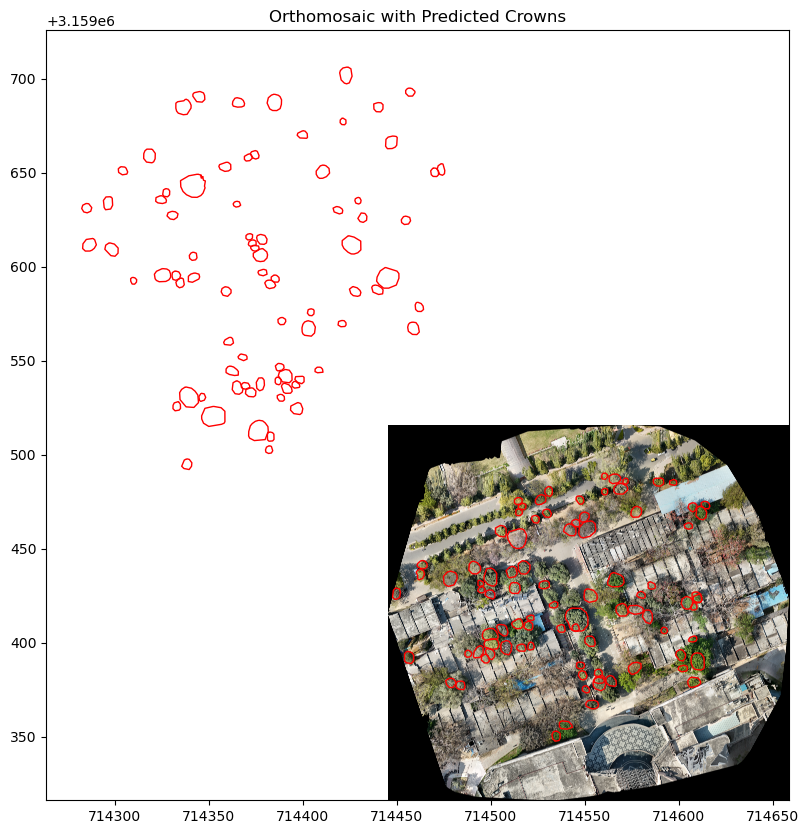

In [10]:
# Set base folder and file paths
base_folder = "large_files"
img_path = os.path.join(base_folder, "lhc_om1.tif")
tiles_path = os.path.join(base_folder, "tiles")  # This folder will be created if it doesn't exist
trained_model_path = os.path.join(base_folder, "urban_trees_Cambridge_20230630.pth")

# Run the tree crown detection pipeline
crowns = tree_crown_detection_pipeline(
    img_path=img_path,
    tiles_path=tiles_path,
    trained_model_path=trained_model_path,
    download_model=False,  # Model is already present locally
    zip_output=False       # Set to True if you want to zip the output tiles folder
)

# Visualize the predicted crowns over the original orthomosaic
visualize_crowns(crowns, img_path)

In [15]:
# Set base folder and file paths
base_folder = "large_files"
img_path = os.path.join(base_folder, "lhc_om1.tif")
tiles_path = os.path.join(base_folder, "tiles")  # This folder will be created if it doesn't exist
trained_model_path = os.path.join(base_folder, "230103_randresize_full.pth")

# Run the tree crown detection pipeline
crowns = tree_crown_detection_pipeline(
    img_path=img_path,
    tiles_path=tiles_path,
    trained_model_path=trained_model_path,
    download_model=False,  # Model is already present locally
    zip_output=False       # Set to True if you want to zip the output tiles folder
)

# Visualize the predicted crowns over the original orthomosaic
visualize_crowns(crowns, img_path)

DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0907b5c0d0>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f090852b610> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f090852b610>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0907b5c0d0>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/lhc_om1.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0907b5c0d0>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f090852b610> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f090852b610>.
DEBUG: Exiting o

  0%|          | 0/9 [00:00<?, ?it/s]

DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0907b5ebc0>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f09077e9a80> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f09077e9a80>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0907b5ebc0>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/lhc_om1.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0907b5ebc0>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f09077e9a80> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f09077e9a80>.
DEBUG: Exiting o

KeyboardInterrupt: 

DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0907b5c040>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f090778f160> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f090778f160>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0907b5c040>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/lhc_om1.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0907b5c040>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f090778f160> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f090778f160>.
DEBUG: Exiting o

DEBUG: IO window xoff=0.0 yoff=0.0 width=9836.0 height=9193.0


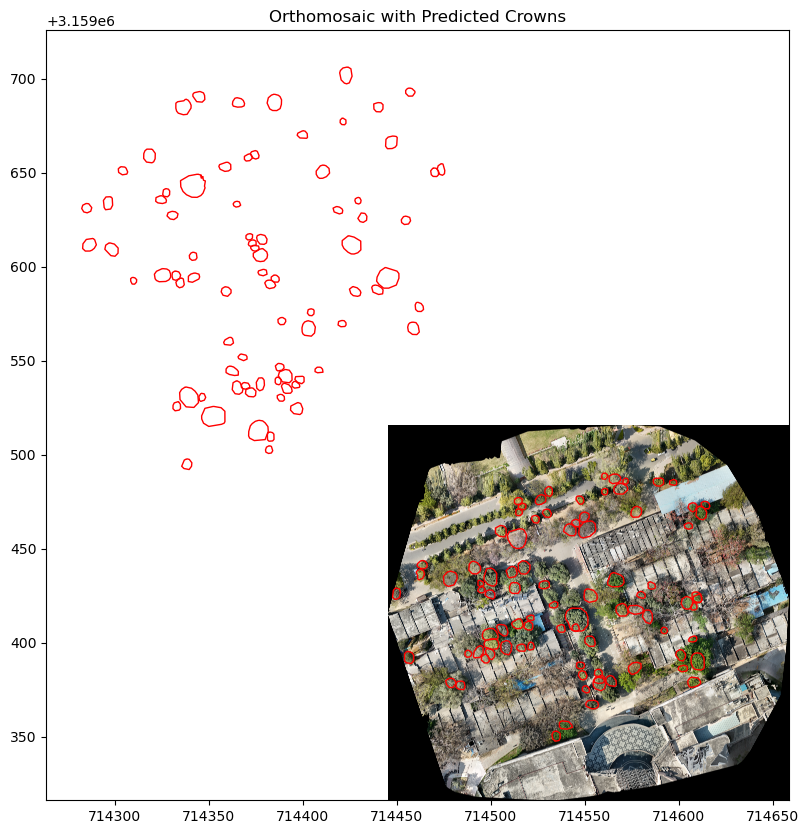

DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f090778f160>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f0907b5c040> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f0907b5c040>.
DEBUG: Exiting outermost env
DEBUG: Exited env context: <rasterio.env.Env object at 0x7f090778f160>


In [14]:
# plot crowns over image
import matplotlib.pyplot as plt

base_folder = "large_files"
img_path = os.path.join(base_folder, "lhc_om1.tif")

with rasterio.open(img_path) as src:
    fig, ax = plt.subplots(figsize=(10, 10))
    show(src, ax=ax)
    crowns.plot(ax=ax, facecolor='none', edgecolor='red')
    ax.set_title("Orthomosaic with Predicted Crowns")
    plt.show()


DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0908578910>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f090854e380> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f090854e380>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0908578910>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/om1.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0908578910>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f090854e380> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f090854e380>.
DEBUG: Exiting outer

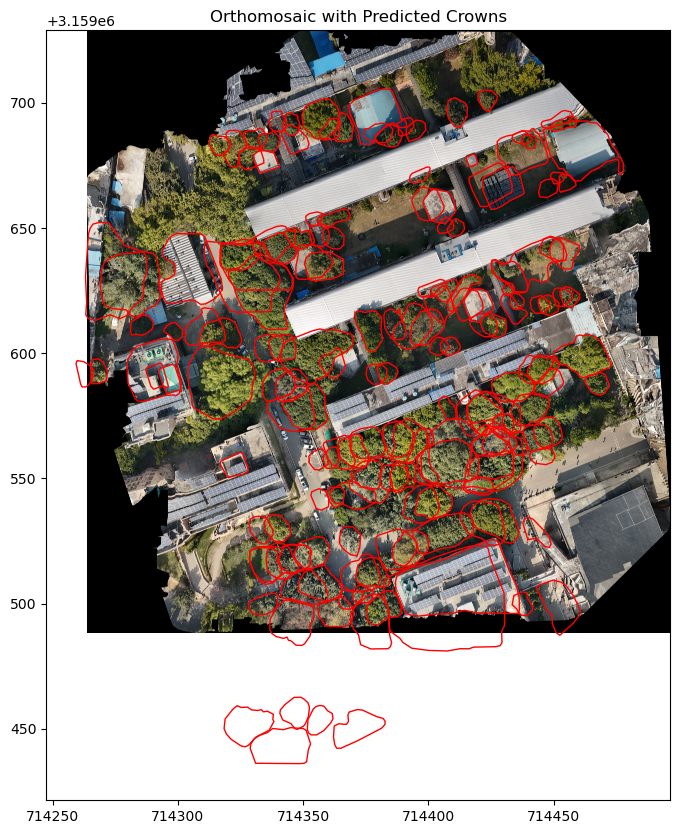

In [11]:
import os
import pandas as pd
import geopandas as gpd
from shapely.geometry import Polygon

def merge_common_crowns_iou(crowns1, crowns2, iou_threshold=0.5):
    """
    Merge common crowns from two GeoDataFrames based on Intersection over Union (IoU).

    Parameters
    ----------
    crowns1 : GeoDataFrame
        First set of detected crowns.
    crowns2 : GeoDataFrame
        Second set of detected crowns.
    iou_threshold : float, optional
        Minimum IoU to consider two crowns as the same (default is 0.5).

    Returns
    -------
    merged : GeoDataFrame
        GeoDataFrame with merged crown geometries.
    """
    merged = crowns1.copy()

    # Iterate over each crown in crowns2
    for idx2, row2 in crowns2.iterrows():
        poly2 = row2.geometry
        found_match = False
        for idx1, row1 in merged.iterrows():
            poly1 = row1.geometry
            inter_area = poly1.intersection(poly2).area
            union_area = poly1.union(poly2).area
            iou = inter_area / union_area if union_area > 0 else 0
            if iou >= iou_threshold:
                # Merge the two polygons by union.
                merged.at[idx1, 'geometry'] = poly1.union(poly2)
                found_match = True
                break
        if not found_match:
            # Use pd.concat instead of append
            merged = pd.concat([merged, row2.to_frame().T], ignore_index=True)
    return merged

def merge_common_crowns_euclidean(crowns1, crowns2, distance_threshold=10):
    """
    Merge common crowns from two GeoDataFrames based on Euclidean distance between centroids.

    Parameters
    ----------
    crowns1 : GeoDataFrame
        First set of detected crowns.
    crowns2 : GeoDataFrame
        Second set of detected crowns.
    distance_threshold : float, optional
        Maximum distance between centroids to consider two crowns the same (default is 10).

    Returns
    -------
    merged : GeoDataFrame
        GeoDataFrame with merged crown geometries.
    """
    merged = crowns1.copy()

    for idx2, row2 in crowns2.iterrows():
        centroid2 = row2.geometry.centroid
        found_match = False
        for idx1, row1 in merged.iterrows():
            centroid1 = row1.geometry.centroid
            if centroid1.distance(centroid2) <= distance_threshold:
                merged.at[idx1, 'geometry'] = row1.geometry.union(row2.geometry)
                found_match = True
                break
        if not found_match:
            merged = pd.concat([merged, row2.to_frame().T], ignore_index=True)
    return merged

# Merge the crowns using IoU filtering
merged_crowns = merge_common_crowns_iou(crowns1, crowns2, iou_threshold=0.5)

# Alternatively, merge using Euclidean distance:
# merged_crowns = merge_common_crowns_euclidean(crowns1, crowns2, distance_threshold=10)

# Visualize merged crowns overlayed on om1.tif (or choose any orthomosaic for background)
visualize_crowns(merged_crowns, img_path1)


DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0907a71390>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f0907a71810> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f0907a71810>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0907a71390>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/om1.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0907a71390>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f0907a71810> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f0907a71810>.
DEBUG: Exiting outer

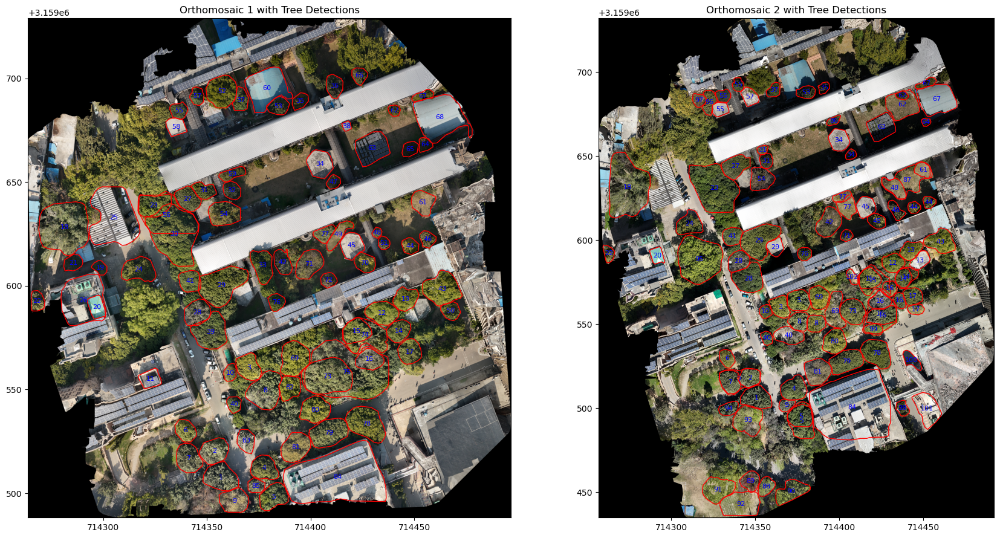

In [18]:
import os
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show

def assign_tree_ids(crowns1, crowns2, distance_threshold=10):
    """
    Assign a unique tree ID to crowns from two GeoDataFrames. Crowns that are close
    (based on centroid Euclidean distance) will be considered the same tree and will
    receive the same tree_id.

    Parameters
    ----------
    crowns1 : GeoDataFrame
        Detected crowns from the first orthomosaic.
    crowns2 : GeoDataFrame
        Detected crowns from the second orthomosaic.
    distance_threshold : float, optional
        Maximum distance between centroids (in CRS units) to consider them the same tree.
    
    Returns
    -------
    crowns1_new : GeoDataFrame
        Copy of crowns1 with a new column 'tree_id'.
    crowns2_new : GeoDataFrame
        Copy of crowns2 with a new column 'tree_id'.
    """
    # Work on copies so as not to modify originals.
    crowns1_new = crowns1.copy()
    crowns2_new = crowns2.copy()
    
    # Assign unique IDs to crowns1
    crowns1_new["tree_id"] = range(1, len(crowns1_new) + 1)
    next_id = crowns1_new["tree_id"].max() + 1

    # For each crown in crowns2, try to match with crowns1 via centroid distance.
    tree_ids = []
    for idx2, row2 in crowns2_new.iterrows():
        centroid2 = row2.geometry.centroid
        matched_id = None
        # Check against all crowns in crowns1_new
        for idx1, row1 in crowns1_new.iterrows():
            centroid1 = row1.geometry.centroid
            if centroid1.distance(centroid2) <= distance_threshold:
                matched_id = row1.tree_id
                break
        if matched_id is None:
            matched_id = next_id
            next_id += 1
        tree_ids.append(matched_id)
    crowns2_new["tree_id"] = tree_ids
    return crowns1_new, crowns2_new

def visualize_dual_orthomosaics_with_ids(img_path1, crowns1, img_path2, crowns2):
    """
    Visualize two orthomosaics side by side with overlaid tree crown detections.
    Each crown is annotated with its tree_id.

    Parameters
    ----------
    img_path1 : str
        Path to the first orthomosaic image.
    crowns1 : GeoDataFrame
        Detected crowns for the first orthomosaic (must contain 'tree_id').
    img_path2 : str
        Path to the second orthomosaic image.
    crowns2 : GeoDataFrame
        Detected crowns for the second orthomosaic (must contain 'tree_id').
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 9))
    
    # Plot first orthomosaic
    with rasterio.open(img_path1) as src1:
        show(src1, ax=ax1)
    crowns1.plot(ax=ax1, facecolor="none", edgecolor="red", linewidth=1)
    # Annotate each crown with its tree_id.
    for _, row in crowns1.iterrows():
        centroid = row.geometry.centroid
        ax1.text(centroid.x, centroid.y, str(row.tree_id), color="blue",
                 fontsize=8, ha="center", va="center")
    ax1.set_title("Orthomosaic 1 with Tree Detections")
    
    # Plot second orthomosaic
    with rasterio.open(img_path2) as src2:
        show(src2, ax=ax2)
    crowns2.plot(ax=ax2, facecolor="none", edgecolor="red", linewidth=1)
    # Annotate each crown with its tree_id.
    for _, row in crowns2.iterrows():
        centroid = row.geometry.centroid
        ax2.text(centroid.x, centroid.y, str(row.tree_id), color="blue",
                 fontsize=8, ha="center", va="center")
    ax2.set_title("Orthomosaic 2 with Tree Detections")
    
    plt.tight_layout()
    plt.savefig('high_def_output.png', dpi=300)
    plt.show()

# Assign the same tree IDs for matching crowns across the two orthomosaics.
crowns1_new, crowns2_new = assign_tree_ids(crowns1, crowns2, distance_threshold=10)

# Visualize the two images side by side with overlaid, annotated detections.
visualize_dual_orthomosaics_with_ids(img_path1, crowns1_new, img_path2, crowns2_new)


DEBUG: Entering env context: <rasterio.env.Env object at 0x7f0907b0fc70>
DEBUG: Starting outermost env
DEBUG: No GDAL environment exists
DEBUG: New GDAL environment <rasterio._env.GDALEnv object at 0x7f0907b0ee00> created
DEBUG: GDAL_DATA found in environment.
DEBUG: PROJ_DATA found in environment.
DEBUG: Started GDALEnv: self=<rasterio._env.GDALEnv object at 0x7f0907b0ee00>.
DEBUG: Entered env context: <rasterio.env.Env object at 0x7f0907b0fc70>
DEBUG: Sharing flag: 0
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Nodata success: 0, Nodata value: 0.000000
DEBUG: Dataset <open DatasetReader name='large_files/om1.tif' mode='r'> is started.
DEBUG: Exiting env context: <rasterio.env.Env object at 0x7f0907b0fc70>
DEBUG: Cleared existing <rasterio._env.GDALEnv object at 0x7f0907b0ee00> options
DEBUG: Stopped GDALEnv <rasterio._env.GDALEnv object at 0x7f0907b0ee00>.
DEBUG: Exiting outer

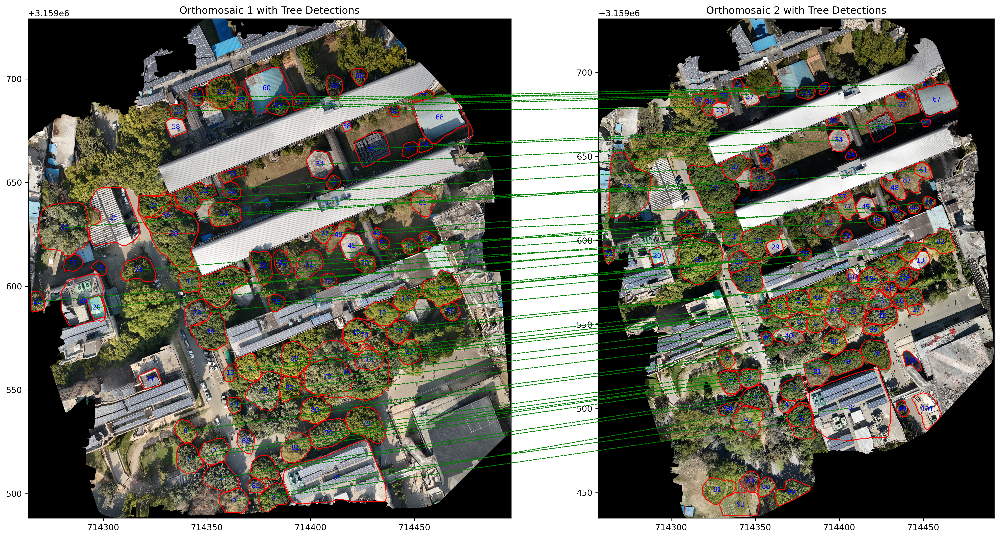

In [19]:
import os
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show
from matplotlib.patches import ConnectionPatch

def assign_tree_ids(crowns1, crowns2, distance_threshold=10):
    """
    Assign a unique tree ID to crowns from two GeoDataFrames. Crowns that are close
    (based on centroid Euclidean distance) will be considered the same tree and will
    receive the same tree_id.

    Parameters
    ----------
    crowns1 : GeoDataFrame
        Detected crowns from the first orthomosaic.
    crowns2 : GeoDataFrame
        Detected crowns from the second orthomosaic.
    distance_threshold : float, optional
        Maximum distance between centroids (in CRS units) to consider them the same tree.
    
    Returns
    -------
    crowns1_new : GeoDataFrame
        Copy of crowns1 with a new column 'tree_id'.
    crowns2_new : GeoDataFrame
        Copy of crowns2 with a new column 'tree_id'.
    """
    # Work on copies so as not to modify originals.
    crowns1_new = crowns1.copy()
    crowns2_new = crowns2.copy()
    
    # Assign unique IDs to crowns1
    crowns1_new["tree_id"] = range(1, len(crowns1_new) + 1)
    next_id = crowns1_new["tree_id"].max() + 1

    # For each crown in crowns2, try to match with crowns1 via centroid distance.
    tree_ids = []
    for idx2, row2 in crowns2_new.iterrows():
        centroid2 = row2.geometry.centroid
        matched_id = None
        # Check against all crowns in crowns1_new
        for idx1, row1 in crowns1_new.iterrows():
            centroid1 = row1.geometry.centroid
            if centroid1.distance(centroid2) <= distance_threshold:
                matched_id = row1.tree_id
                break
        if matched_id is None:
            matched_id = next_id
            next_id += 1
        tree_ids.append(matched_id)
    crowns2_new["tree_id"] = tree_ids
    return crowns1_new, crowns2_new

def visualize_dual_orthomosaics_with_ids(img_path1, crowns1, img_path2, crowns2, save_path='high_def_output.png'):
    """
    Visualize two orthomosaics side by side with overlaid tree crown detections.
    Each crown is annotated with its tree_id and the same trees across the images
    are linked with a dashed line.

    Parameters
    ----------
    img_path1 : str
        Path to the first orthomosaic image.
    crowns1 : GeoDataFrame
        Detected crowns for the first orthomosaic (must contain 'tree_id').
    img_path2 : str
        Path to the second orthomosaic image.
    crowns2 : GeoDataFrame
        Detected crowns for the second orthomosaic (must contain 'tree_id').
    save_path : str, optional
        If provided, save the high-resolution output image to this file.
    """
    # Create a high-DPI figure.
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 9), dpi=300)
    
    # Plot first orthomosaic.
    with rasterio.open(img_path1) as src1:
        show(src1, ax=ax1)
    crowns1.plot(ax=ax1, facecolor="none", edgecolor="red", linewidth=1)
    # Annotate each crown with its tree_id.
    for _, row in crowns1.iterrows():
        centroid = row.geometry.centroid
        ax1.text(centroid.x, centroid.y, str(row.tree_id), color="blue",
                 fontsize=8, ha="center", va="center")
    ax1.set_title("Orthomosaic 1 with Tree Detections")
    
    # Plot second orthomosaic.
    with rasterio.open(img_path2) as src2:
        show(src2, ax=ax2)
    crowns2.plot(ax=ax2, facecolor="none", edgecolor="red", linewidth=1)
    # Annotate each crown with its tree_id.
    for _, row in crowns2.iterrows():
        centroid = row.geometry.centroid
        ax2.text(centroid.x, centroid.y, str(row.tree_id), color="blue",
                 fontsize=8, ha="center", va="center")
    ax2.set_title("Orthomosaic 2 with Tree Detections")
    
    # Draw connection lines for crowns with the same tree_id.
    common_ids = set(crowns1["tree_id"]).intersection(set(crowns2["tree_id"]))
    for tid in common_ids:
        row1 = crowns1[crowns1["tree_id"] == tid].iloc[0]
        row2 = crowns2[crowns2["tree_id"] == tid].iloc[0]
        centroid1 = row1.geometry.centroid
        centroid2 = row2.geometry.centroid
        # Create a ConnectionPatch linking the two centroids across the axes.
        con = ConnectionPatch(xyA=(centroid1.x, centroid1.y), xyB=(centroid2.x, centroid2.y),
                              coordsA="data", coordsB="data", axesA=ax1, axesB=ax2,
                              color="green", linestyle="--", linewidth=1)
        fig.add_artist(con)
    
    plt.tight_layout()
    plt.savefig(save_path, dpi=300)
    plt.show()

# Example usage:
# (Assuming crowns1 and crowns2 have already been obtained via your detection pipeline,
# and img_path1 and img_path2 point to om1.tif and om2.tif respectively.)

# Example:
crowns1_new, crowns2_new = assign_tree_ids(crowns1, crowns2, distance_threshold=10)
visualize_dual_orthomosaics_with_ids(img_path1, crowns1_new, img_path2, crowns2_new)
